In [11]:
########## 1

!pip install --quiet shap
!git clone --depth 1 https://github.com/ultralytics/yolov5
!wget -q https://github.com/ultralytics/yolov5/releases/download/v7.0/yolov5s-seg.pt
%cd yolov5
!pip install --quiet -r requirements.txt
%cd /kaggle/working

fatal: destination path 'yolov5' already exists and is not an empty directory.
/kaggle/working/yolov5
/kaggle/working


In [12]:
########## 2

import sys, random, math, json
from pathlib import Path
import numpy as np, pandas as pd
import cv2, torch, matplotlib.pyplot as plt, matplotlib.patches as patches
from PIL import Image
from IPython.display import display

# YOLO utils
sys.path.append('/kaggle/working/yolov5')
from utils.general import non_max_suppression, box_iou

# I/O and runtime settings
OUT_DIR   = Path('/kaggle/working/output'); OUT_DIR.mkdir(exist_ok=True)
DEVICE    = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

IMG_SIZE  = 160      # network input (square)
CONF_T    = 0.50     # NMS confidence threshold
IOU_T     = 0.50     # NMS IoU threshold
SP_W      = 4        # super-pixel width

FIG_W, FIG_H, DPI = 8, 8, 300       # width, height (inch) & resolution
plt.rcParams.update({
    'figure.figsize': (FIG_W, FIG_H),
    'savefig.dpi'   : DPI,
    'font.size'     : 10
})
print('Matplotlib defaults set →', f'{FIG_W}"×{FIG_H}" @ {DPI} dpi')

Matplotlib defaults set → 8"×8" @ 300 dpi


In [13]:
########## 3

def rgb2gray(arr):
    return np.dot(arr[...,:3], [0.2989, 0.5870, 0.1140])

img_org = cv2.imread('/kaggle/input/newdatachicken/9-weeks.jpg')
img_org = cv2.cvtColor(img_org, cv2.COLOR_BGR2RGB)

h0, w0   = img_org.shape[:2]
ratio    = IMG_SIZE / max(h0, w0)
nh, nw   = int(h0*ratio), int(w0*ratio)
img      = cv2.resize(img_org, (nw, nh))

dh, dw   = IMG_SIZE-nh, IMG_SIZE-nw
top, bot = dh//2, dh-dh//2
lft, rgt = dw//2, dw-dw//2
img      = cv2.copyMakeBorder(img, top, bot, lft, rgt,
                              cv2.BORDER_CONSTANT, value=(0,0,0))
img      = img.astype('float32')/255.0
img_gray = rgb2gray(img)

plt.imsave(OUT_DIR/'original_image.png',          img_org)
plt.imsave(OUT_DIR/'processed_gray_comparison.png', img_gray, cmap='gray')
print('Image loaded and letter-boxed to', img.shape[:2])

Image loaded and letter-boxed to (160, 160)


In [14]:
########## 4

ckpt  = torch.load('/kaggle/working/yolov5s-seg.pt', map_location=DEVICE)
model = ckpt['model'].float().eval().to(DEVICE).half()

# guarantee dict[int → str] and default for unknown IDs
if isinstance(model.names, (list, tuple)):
    model.names = {i:n for i,n in enumerate(model.names)}
model.names = {int(k):v for k,v in model.names.items()}
NUM_CLASSES = int(model.model[-1].nc)           # 80 for COCO

print('Model loaded –', NUM_CLASSES, 'classes')

Model loaded – 80 classes


In [15]:
########## 5

t_img = torch.from_numpy(img.transpose(2, 0, 1)).unsqueeze(0).to(DEVICE).half()
with torch.no_grad():
    pred_tuple = model(t_img)                      # (pred, proto)

pred  = pred_tuple[0]
dets  = non_max_suppression(pred, CONF_T, IOU_T)[0]

print(f'\nDetected {len(dets)} object(s):')
for i, det in enumerate(dets.cpu().numpy()):
    x1, y1, x2, y2, conf_raw, cls, *rest = det      # rest = mask coeffs (ignored)
    conf = max(0.0, min(float(conf_raw), 1.0))      # clamp to [0,1]
    name = model.names.get(int(cls), f'class_{int(cls)}')
    print(f'  idx={i:2d} │ box=({x1:.0f},{y1:.0f})–({x2:.0f},{y2:.0f}) '
          f'│ score={conf*100:5.1f}% │ class={name}')



Detected 4 object(s):
  idx= 0 │ box=(26,77)–(69,129) │ score=100.0% │ class=class_96
  idx= 1 │ box=(96,83)–(156,130) │ score= 89.7% │ class=class_96
  idx= 2 │ box=(62,75)–(101,120) │ score= 82.8% │ class=class_96
  idx= 3 │ box=(92,101)–(122,128) │ score= 75.9% │ class=class_96


In [16]:
# ########## 6

det_path = OUT_DIR / 'detections.png'

fig, ax = plt.subplots()
ax.imshow(img); ax.axis('off')

for i, (x1, y1, x2, y2, conf_raw, cls, *_) in enumerate(dets.cpu().numpy()):
    conf = max(0.0, min(float(conf_raw), 1.0))        # clamp for print
    name = model.names.get(int(cls), f'class_{int(cls)}')
    ax.add_patch(patches.Rectangle((x1, y1), x2-x1, y2-y1,
                                   lw=2, ec='lime', fill=False))
    ax.text(x1, y1, f'#{i} {name} {conf*100:0.1f}%',
            color='red', fontsize=9, va='bottom')
plt.tight_layout()
plt.savefig(det_path)        # DPI taken from global rcParams
plt.close()
print('Detections image saved →', det_path)


Detections image saved → /kaggle/working/output/detections.png


In [17]:
########## 7

class CastNumpy(torch.nn.Module):
    def forward(self, arr: np.ndarray):
        t = torch.from_numpy(np.ascontiguousarray(arr))
        if t.ndim == 3: t = t.unsqueeze(0)
        return t.to(DEVICE).half()

cast_numpy = CastNumpy()

In [24]:
########## 8

# ===== user can change this index any time =====
target_idx = 3                                       # ◀ pick object index here
# ===============================================

assert 0 <= target_idx < len(dets), 'target_idx out of range'

target_det = dets[target_idx].cpu().numpy()          # (x1,y1,x2,y2,conf,cls)

class OD2Score(torch.nn.Module):
    def __init__(self, target, conf_t=0.01, iou_t=0.5):
        super().__init__()
        self.box  = torch.tensor(target[:4], dtype=torch.float32, device=DEVICE)
        self.cls  = int(target[5])
        self.conf_t, self.iou_t = conf_t, iou_t
    def forward(self, x):
        if isinstance(x,(list,tuple)): x = x[0]
        scores = torch.zeros(x.shape[0], device=x.device)
        for b in range(x.shape[0]):
            det = non_max_suppression(x[b].unsqueeze(0),
                                      self.conf_t, self.iou_t,
                                      classes=[self.cls])[0]
            if det is None or not det.shape[0]: continue
            iou,_  = box_iou(det[:,:4], self.box.unsqueeze(0)).max(1)
            best   = torch.argmax(iou)
            score  = det[best,4] * iou[best]
            scores[b] = torch.clamp(score, max=1.0)  # never >1
        return scores.cpu().numpy()

score_layer = OD2Score(target_det, CONF_T, IOU_T)
s_val = float(score_layer.forward(pred_tuple)[0])
print(f'\nScore for object #{target_idx}: {s_val*100:0.2f}%')


Score for object #3: 75.88%


In [25]:
########## 9

class SuperPixler(torch.nn.Module):
    """
    Replaces selected super-pixels by the mean color of the image.
    """
    def __init__(self, image_rgb: np.ndarray, sp_w: int):
        super().__init__()
        self.base  = np.expand_dims(image_rgb.transpose(2, 0, 1), 0)   # (1,C,H,W)
        self.mean  = self.base.mean()
        self.w     = image_rgb.shape[1]
        self.sp_w  = sp_w

    def forward(self, masks: np.ndarray) -> np.ndarray:
        """
        masks  shape = (batch, N_SP)  ;  1 = hide, 0 = keep
        returns numpy batch (B,C,H,W)
        """
        out = np.repeat(self.base.copy(), masks.shape[0], axis=0)
        for sp in range(masks.shape[1]):
            x0 = (sp // (self.w // self.sp_w)) * self.sp_w
            y0 = (sp %  (self.w // self.sp_w)) * self.sp_w
            out[masks[:, sp].astype(bool), :, x0:x0+self.sp_w, y0:y0+self.sp_w] = self.mean
        return out


# --- build super-pixeller ----------------------------------------------------
N_SP     = int((IMG_SIZE / SP_W) ** 2)
superpix = SuperPixler(img, SP_W)

# --- create demo masks -------------------------------------------------------
top_half_mask     = np.array([1] * (N_SP//2) + [0] * (N_SP - N_SP//2), dtype=int)
random_half_mask  = np.random.randint(0, 2, size=N_SP, dtype=int)

demo_masks  = np.vstack([top_half_mask, random_half_mask])          # (2, N_SP)
demo_batch  = superpix.forward(demo_masks)                          # (2,C,H,W)

# --- save comparison figure --------------------------------------------------
fig, axs = plt.subplots(1, 2, figsize=(FIG_W*2/3, FIG_H/1.5))  # wider ratio
titles   = ['Top half hidden', 'Random half hidden']
for i in range(2):
    axs[i].imshow(demo_batch[i].transpose(1, 2, 0))
    axs[i].set_title(titles[i])
    axs[i].axis('off')
plt.tight_layout()
plt.savefig(OUT_DIR / 'superpixel_comparison.png')
plt.close()
print('Super-pixel comparison saved →', OUT_DIR / 'superpixel_comparison.png')

# --- assemble final SHAP model ----------------------------------------------
shap_model = torch.nn.Sequential(
    superpix,          # numpy -> (B,C,H,W) numpy
    CastNumpy(),       # numpy -> torch
    model,             # YOLOv5-Seg  (returns (pred, proto))
    score_layer        # converts prediction to single score
)
print('SHAP model assembled (SuperPixler ➜ CastNumpy ➜ YOLO ➜ Score)')


Super-pixel comparison saved → /kaggle/working/output/superpixel_comparison.png
SHAP model assembled (SuperPixler ➜ CastNumpy ➜ YOLO ➜ Score)


In [26]:
########## 10

import shap
shap.initjs()

background = np.ones((1, N_SP), int)    # fully hidden
to_explain = np.zeros((1, N_SP), int)   # original image

explainer  = shap.KernelExplainer(shap_model, background)

BATCHES, NSAMPLES = 25, 2000
collected = np.zeros(N_SP)

for b in range(BATCHES):
    print(f'Batch {b+1}/{BATCHES} … ', end='')
    sv = explainer.shap_values(to_explain, nsamples=NSAMPLES)[0]
    better = np.abs(sv) > np.abs(collected)
    collected[better] = sv[better]
    print('done.')

print('\nNon-zero super-pixels:', (collected!=0).sum())
shap.force_plot(explainer.expected_value, collected)   # interactive view

Batch 1/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 2/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 3/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 4/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 5/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 6/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 7/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 8/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 9/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 10/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 11/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 12/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 13/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 14/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 15/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 16/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 17/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 18/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 19/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 20/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 21/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 22/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 23/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 24/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.
Batch 25/25 … 

  0%|          | 0/1 [00:00<?, ?it/s]

done.

Non-zero super-pixels: 1598


In [27]:
########## 11

# 1) map SHAP → pixel space
shap_2d   = collected.reshape(IMG_SIZE//SP_W, IMG_SIZE//SP_W)
shap_px   = np.repeat(np.repeat(shap_2d, SP_W,0), SP_W,1)
scale     = 2*np.max(np.abs(collected))+1e-9
shap_vis  = shap_px/scale + 0.5                        # [0..1]

x1,y1,x2,y2 = map(int, target_det[:4])
shap_mask = np.zeros_like(shap_vis); shap_mask[y1:y2,x1:x2] = shap_vis[y1:y2,x1:x2]

# 2) save full heat-map
fig,ax=plt.subplots(figsize=(8,8))
ax.imshow(img_gray,cmap='gray',vmin=0,vmax=1,alpha=0.7)
ax.imshow(shap_mask,cmap='seismic',vmin=0,vmax=1,alpha=0.5)
cls_name = model.names.get(int(target_det[5]), f'class_{int(target_det[5])}')
ax.text(x1,y1,f'{cls_name} {target_det[4]*100:0.1f}%',color='green')
ax.add_patch(patches.Rectangle((x1,y1),x2-x1,y2-y1,ec='lime',lw=2,fill=False,ls='--'))
plt.savefig(OUT_DIR/'shap_heatmap.png'); plt.close()

# 3) cropped RGB + SHAP + big 0-100 labels
crop_rgb  = img[y1:y2, x1:x2]
crop_shap = shap_vis[y1:y2, x1:x2]
crop_raw  = shap_px[y1:y2, x1:x2]

fig,ax=plt.subplots(figsize=(10,10))
ax.imshow(crop_rgb); ax.imshow(crop_shap,cmap='seismic',vmin=0,vmax=1,alpha=0.5)

# write % importance per super-pixel
mn,mx = shap_px.min(), shap_px.max(); rng = mx-mn if mx!=mn else 1e-9
h,w   = crop_rgb.shape[:2]
for r in range(0,h,SP_W):
    for c in range(0,w,SP_W):
        if r+SP_W>h or c+SP_W>w: continue
        pct = (crop_raw[r,c]-mn)/rng*100
        ax.text(c+SP_W//2, r+SP_W//2, f'{pct:.0f}',
                ha='center',va='center',color='white',fontsize=12,
                bbox=dict(facecolor='black',alpha=0.35,edgecolor='none'))
plt.title('SHAP % importance per super-pixel')
plt.savefig(OUT_DIR/'cropped_object_shap.png', dpi=300, bbox_inches='tight')
plt.imsave(OUT_DIR/'cropped_object_original.png', crop_rgb)
plt.close()

# raw saves
np.save(OUT_DIR/'shap_values.npy', shap_vis)
np.save(OUT_DIR/'superpixel_shap_values.npy', collected)
pd.DataFrame({'superpixel_index':np.arange(N_SP),'shap_value':collected})\
  .to_csv(OUT_DIR/'features_shap_values.csv', index=False)

print('Heat-maps and cropped images saved.')

Heat-maps and cropped images saved.


▶ original_image.png


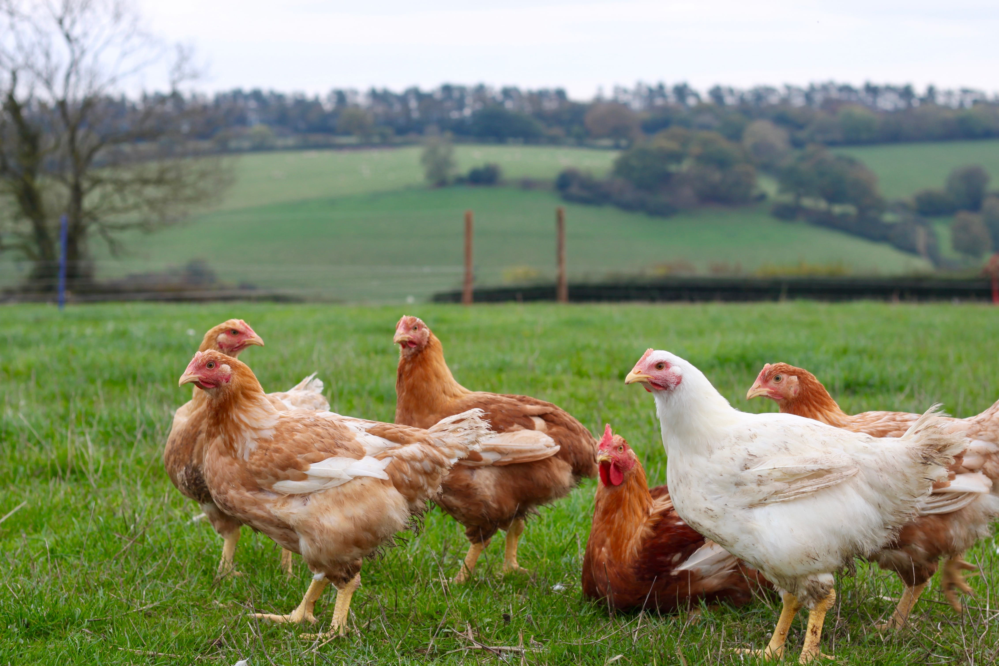

▶ detections.png


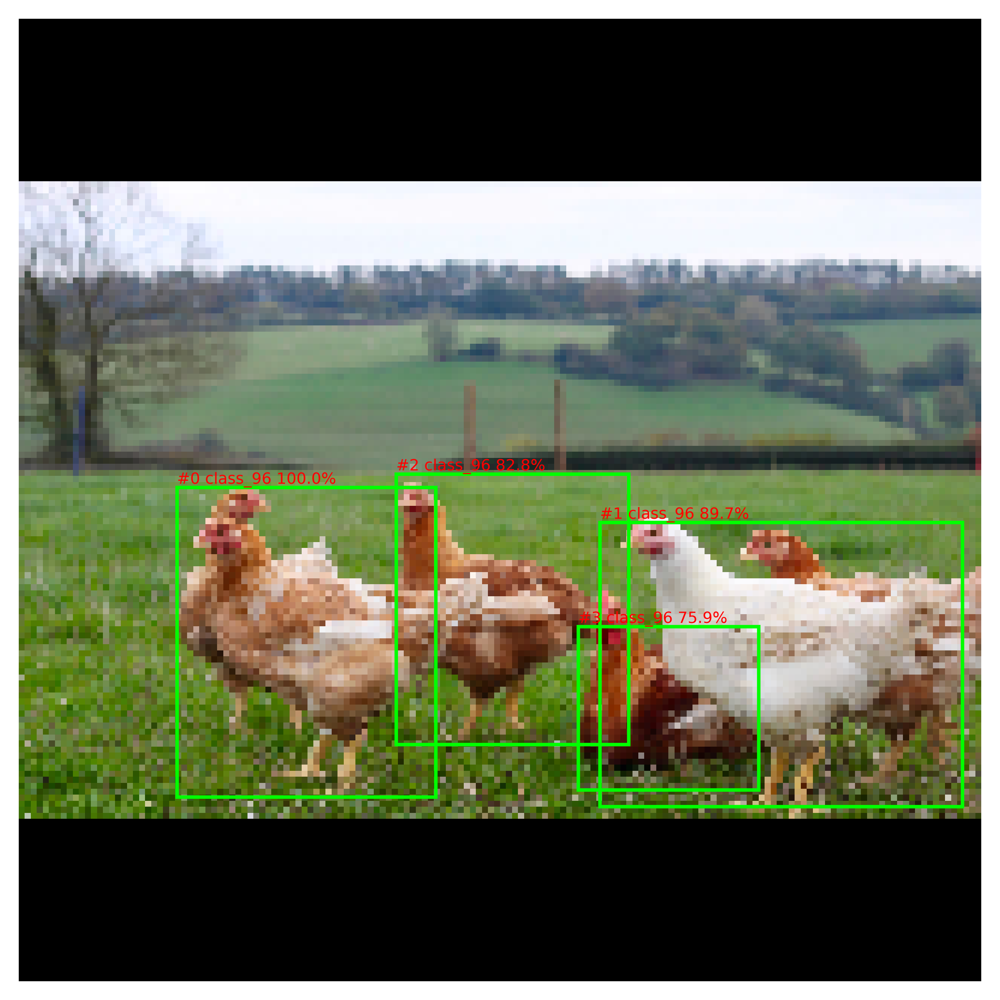

▶ processed_gray_comparison.png


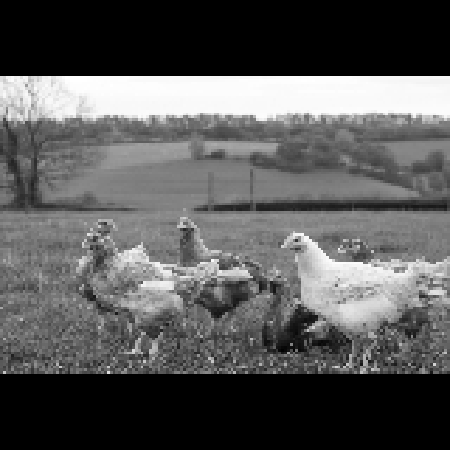

▶ superpixel_comparison.png


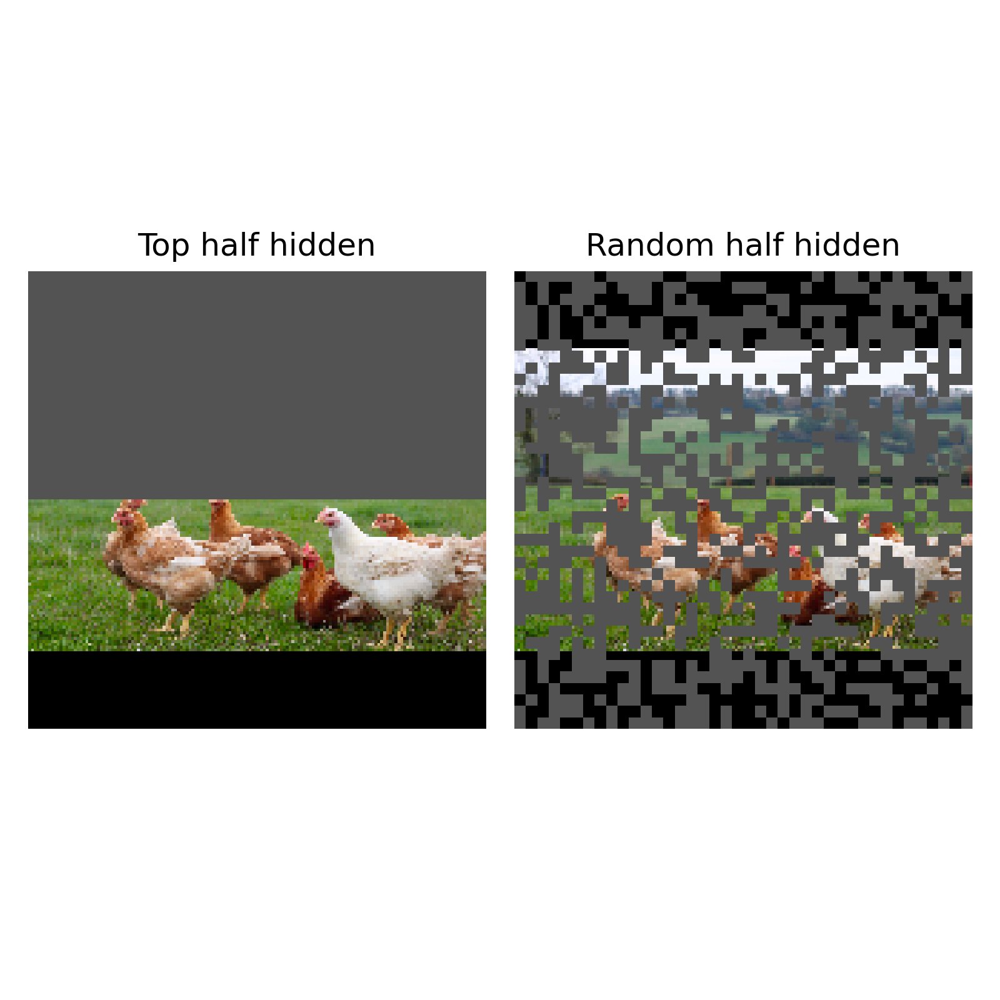

▶ shap_heatmap.png


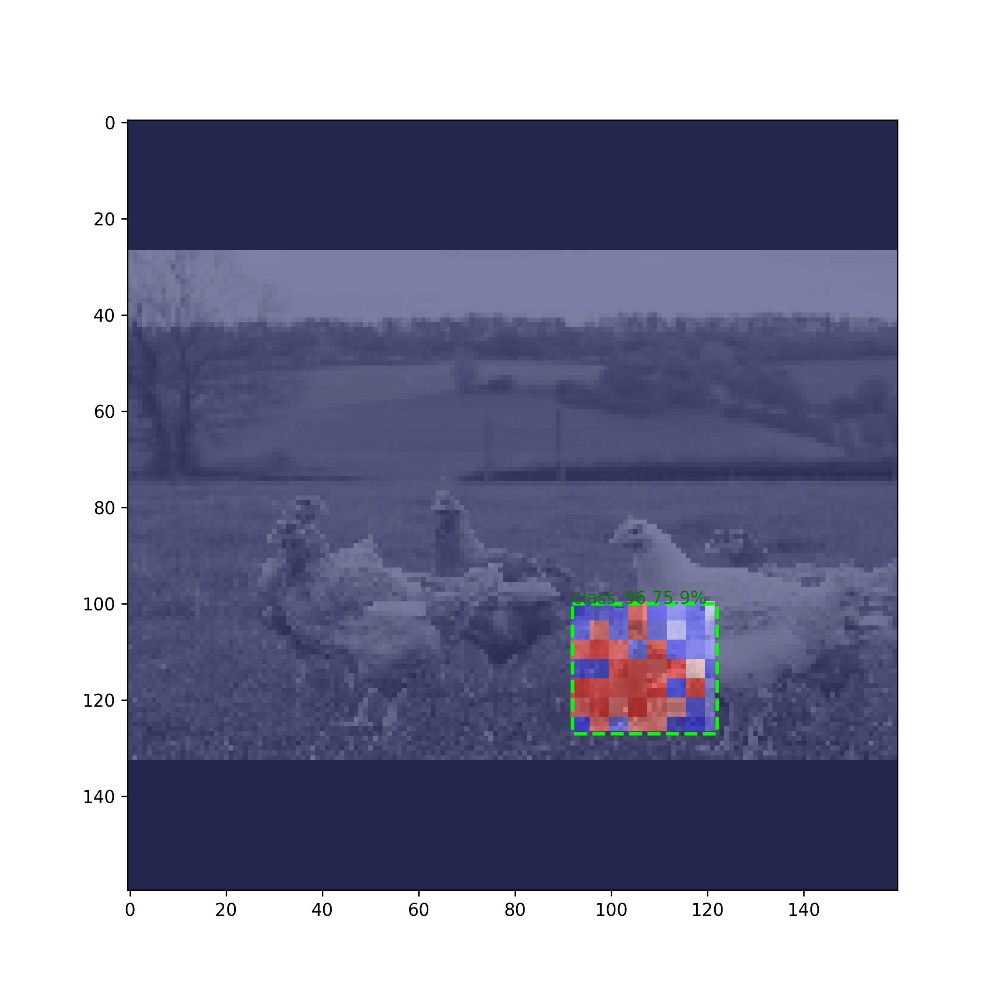

▶ cropped_object_original.png


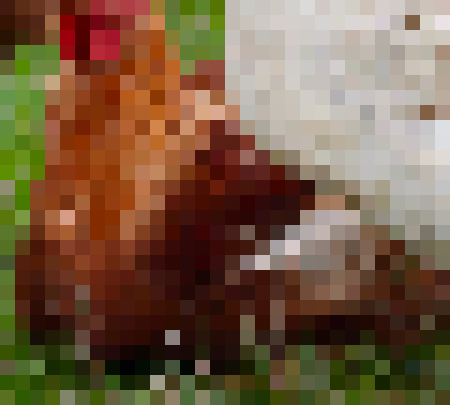

▶ cropped_object_shap.png


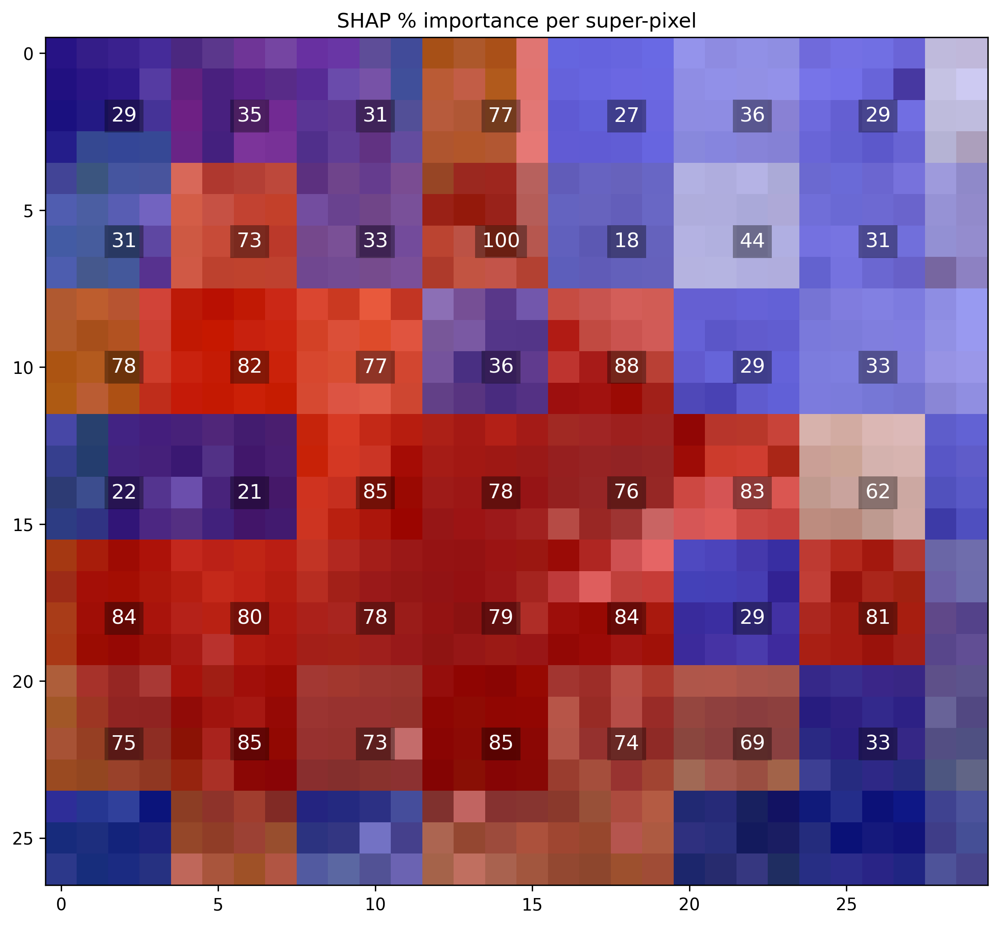

In [28]:
# ########## 12

DISPLAY_MIN = 450   # px

def show(img_path):
    im = Image.open(img_path)
    w, h = im.size
    if max(w, h) < DISPLAY_MIN:
        scale = DISPLAY_MIN / max(w, h)
        im = im.resize((int(w*scale), int(h*scale)), Image.NEAREST)
    display(im)

for fname in ['original_image.png', 'detections.png',
              'processed_gray_comparison.png', 'superpixel_comparison.png',
              'shap_heatmap.png', 'cropped_object_original.png',
              'cropped_object_shap.png']:
    p = OUT_DIR / fname
    if p.exists():
        print('▶', fname)
        show(p)

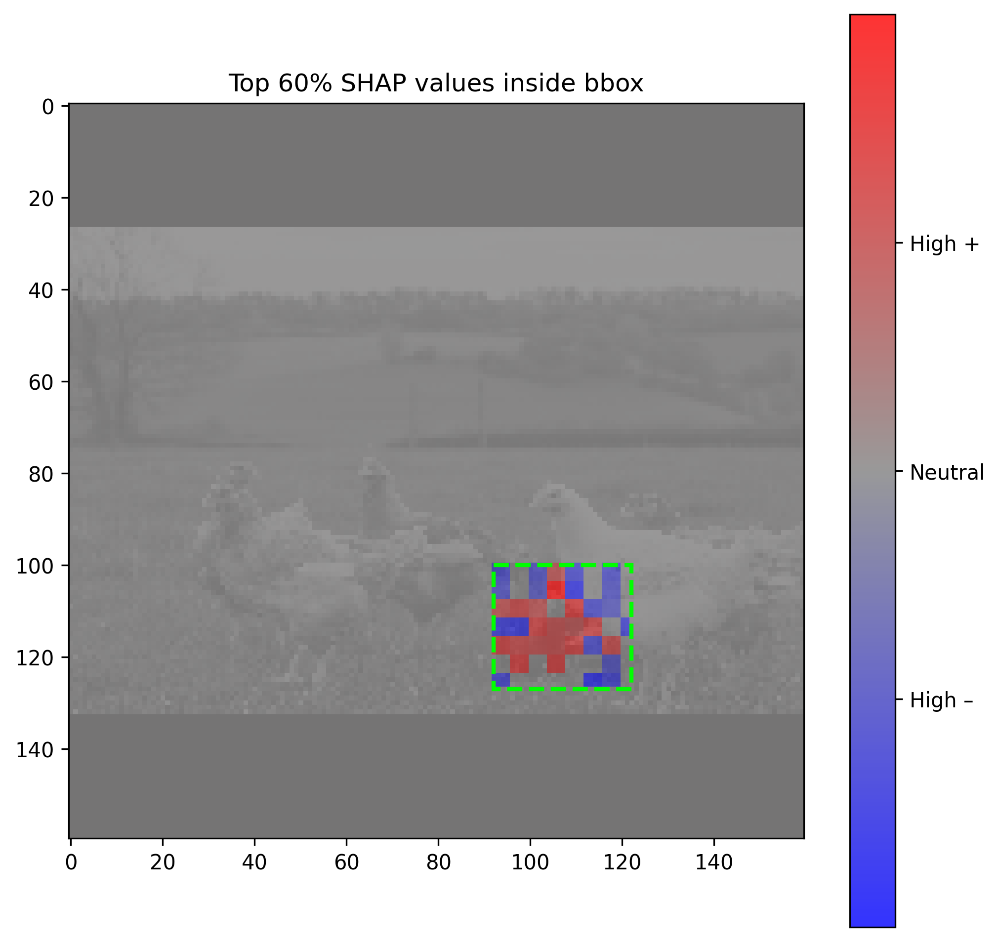

In [31]:
########## 13

from matplotlib.colors import LinearSegmentedColormap

TOP_PCT = 60                                     # change as needed
thr     = np.percentile(np.abs(collected), TOP_PCT)
mask    = np.abs(collected) >= thr
maxval  = np.max(np.abs(collected[mask])) if mask.any() else 1e-9
norm    = np.full_like(collected, 0.5)
norm[mask] = collected[mask]/(2*maxval) + 0.5

norm_px = np.repeat(np.repeat(norm.reshape(IMG_SIZE//SP_W,IMG_SIZE//SP_W),SP_W,0),SP_W,1)
bbox_map= np.full_like(norm_px,0.5); bbox_map[y1:y2,x1:x2]=norm_px[y1:y2,x1:x2]

cmap = LinearSegmentedColormap.from_list('cust',[(0,0,1),(0.5,0.5,0.5),(1,0,0)],256)
fig,ax=plt.subplots(figsize=(8,8))
ax.imshow(img_gray,cmap='gray',vmin=0,vmax=1,alpha=0.7)
im=ax.imshow(bbox_map,cmap=cmap,vmin=0,vmax=1,alpha=0.8)
plt.colorbar(im,ax=ax,ticks=[0.25,0.5,0.75])\
     .ax.set_yticklabels(['High –','Neutral','High +'])
ax.add_patch(patches.Rectangle((x1,y1),x2-x1,y2-y1,ec='lime',lw=2,fill=False,ls='--'))
plt.title(f'Top {TOP_PCT}% SHAP values inside bbox')
top_path = OUT_DIR/'shap_heatmap_top.png'
plt.savefig(top_path, dpi=300, bbox_inches='tight')
plt.close()
display(Image.open(top_path))
